<a href="https://colab.research.google.com/github/DeepabaliChoudhury/UD_Intro_DeepabaliChoudhury/blob/main/CNN_(all_images).ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
import matplotlib.pyplot as plt
import os
from tensorflow.keras.applications import VGG16
from tensorflow.keras.preprocessing import image
from tensorflow.keras.applications.vgg16 import preprocess_input
import numpy as np


In [ ]:
from google.colab import drive
drive.mount('/content/drive/')


Mounted at /content/drive/


In [ ]:
# Specify the directory containing the images
directory = '/content/drive/MyDrive/images/CNN'

# Get a list of all image files in the directory
image_files = [filename for filename in os.listdir(directory) if filename.endswith('.jpg')]


In [ ]:
# Load pre-trained VGG16 model
model = VGG16(weights='imagenet', include_top=False)


58889256/58889256 [==============================] - 0s 0us/step


In [ ]:
def extract_features(image_paths):

    features_list = []

    for img_path in image_paths:
        # Load and preprocess the image
        img = image.load_img(img_path, target_size=(224, 224))  # VGG16 input size
        x = image.img_to_array(img)
        x = np.expand_dims(x, axis=0)
        x = preprocess_input(x)

        # Extract features
        features = model.predict(x)
        features_list.append(features.flatten())  # Flatten the features

    return features_list

  # Get full paths to the images
image_paths = [os.path.join(directory, filename) for filename in image_files]

1/1 [==============================] - 0s 465ms/step


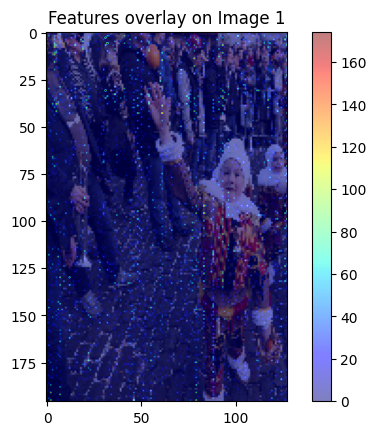

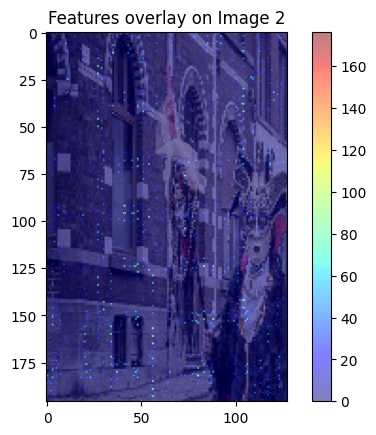

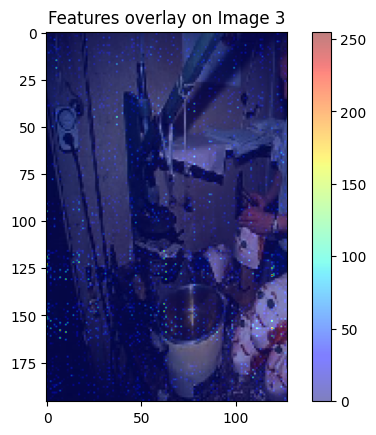

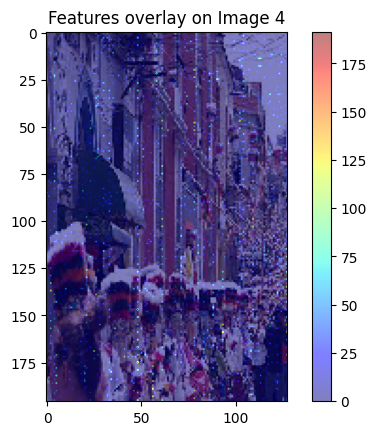

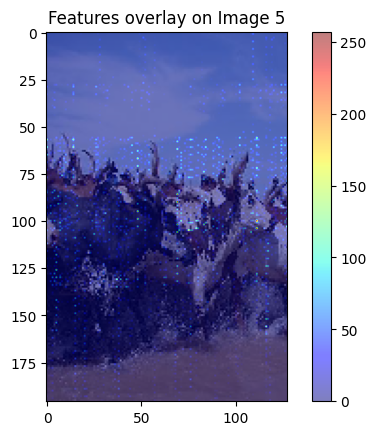

...

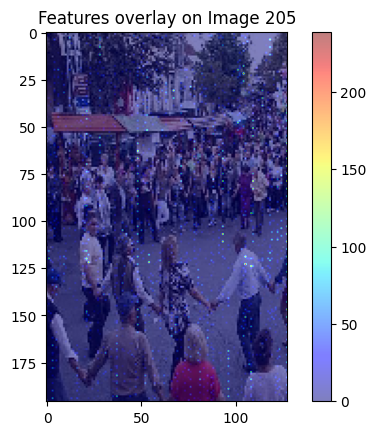

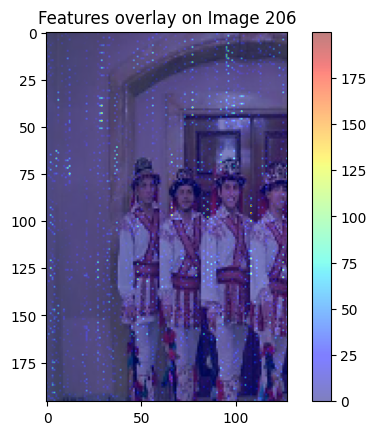

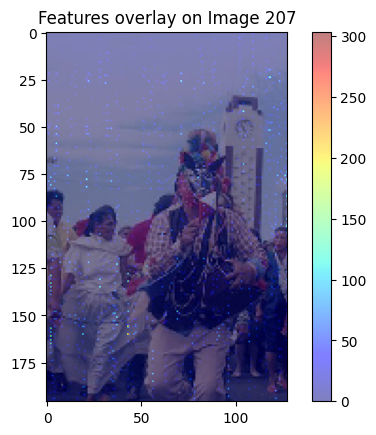

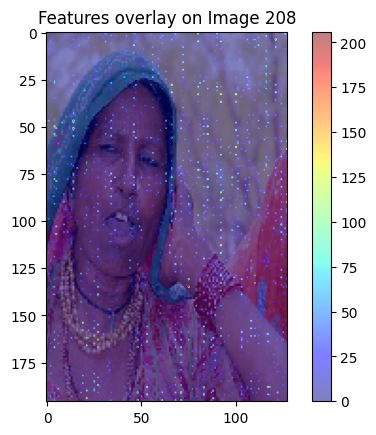

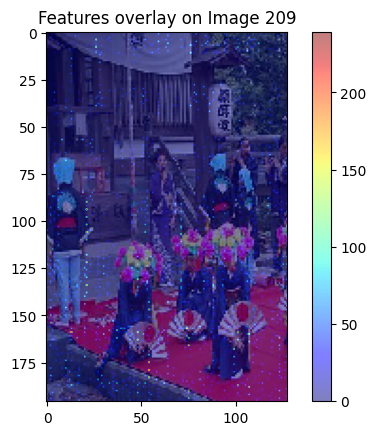

Buffered data was truncated after reaching the output size limit.

In [ ]:

# Extract features
extracted_features = extract_features(image_paths)

# Visualize features on the original images
for i, img_path in enumerate(image_paths):
    img = image.load_img(img_path, target_size=(224, 224))
    features = extracted_features[i]

    plt.figure()
    plt.imshow(img)
    plt.imshow(features.reshape(-1, 128), alpha=0.5, cmap='jet')  # Assuming 128 features
    plt.colorbar()
    plt.title(f"Features overlay on Image {i+1}")
    plt.show()